# Simplified detection of urban types



morphometrics captured by `momepy` in capturing the structure of cities. 

This method is only illustrative and is based on the more extensive one published by Fleischmann et al. (2021) available from [https://github.com/martinfleis/numerical-taxonomy-paper](https://github.com/martinfleis/numerical-taxonomy-paper).

> Fleischmann M, Feliciotti A, Romice O and Porta S (2021) Methodological Foundation of a Numerical Taxonomy of Urban Form. Environment and Planning B: Urban Analytics and City Science, doi: 10.1177/23998083211059835

It depends on the following packages:

```
- momepy
- osmnx
- clustergram
- bokeh
- scikit-learn
- geopy
- ipywidgets
```


In [ ]:
#!pip install geopandas
#!pip install libpysal
#!pip install momepy
#!pip install osmnx
#!pip install pandas
#!pip install clustergram
#!pip instal matplotlib.pyplot
#!pip install bokeh
#!pip install mapclassify
#!pip install matplotlib
#!pip install folium

                                              0.0/7.0 MB ? eta -:--:--
                                              0.0/7.0 MB ? eta -:--:--
                                              0.0/7.0 MB 330.3 kB/s eta 0:00:22
                                              0.1/7.0 MB 657.6 kB/s eta 0:00:11
     -                                        0.3/7.0 MB 1.6 MB/s eta 0:00:05
     -----                                    1.0/7.0 MB 4.9 MB/s eta 0:00:02
     -----------------                        3.0/7.0 MB 12.0 MB/s eta 0:00:01
     ---------------------------------------  7.0/7.0 MB 23.7 MB/s eta 0:00:01
     ---------------------------------------- 7.0/7.0 MB 22.5 MB/s eta 0:00:00
                                              0.0/211.8 kB ? eta -:--:--
     ---------------------------------------- 211.8/211.8 kB ? eta 0:00:00
                                              0.0/162.3 kB ? eta -:--:--
     ---------------------------------------- 162.3/162.3 kB ? eta 0:00:00
  Attempt

In [8]:
import warnings

import geopandas
import libpysal
import momepy
import osmnx
import pandas

from clustergram import Clustergram

import matplotlib.pyplot as plt
from bokeh.io import output_notebook
from bokeh.plotting import show

output_notebook()

Loading BokehJS ...

Pick a place, ideally a town with a good coverage in OpenStreetMap and its local CRS.

We can interactively explore the place we just selected.

## Input data

We can use ``OSMnx`` to quickly download data from OpenStreetMap. If you intend to download larger areas, we recommend using ``pyrosm`` instead.

### Buildings

In [64]:
import geopandas as gpd
# Define the file path
file_path1 = r"D:\Work\UN\Lamu\Data\roads\Buildings_NoOverlaps_Clip.shp"

# Load the shapefile into a GeoDataFrame
gdf1 = gpd.read_file(file_path1)

In [65]:
buildings = gdf1

The OSM input may need a bit of cleaning to ensure only proper polygons are kept.

In [66]:
buildings.geom_type.value_counts()

Polygon         328271
MultiPolygon         2
dtype: int64

In [67]:
buildings = buildings[buildings.geom_type == "Polygon"].reset_index(drop=True)

In [68]:
local_crs = 26332 

And we should re-project the data from WGS84 to the local projection in meters (momepy default values assume meters not feet or degrees). We will also drop unnecessary columns.

In [69]:
buildings = buildings[["geometry"]].to_crs(local_crs)

Finally, we can assign unique ID to each row.

In [70]:
buildings["uID"] = range(len(buildings))
buildings.head()

,geometry,uID
0,"POLYGON Z ((312097.516 557084.023 0.000, 31209...",0
1,"POLYGON Z ((315924.278 557084.023 0.000, 31591...",1
2,"POLYGON Z ((310886.893 557084.023 0.000, 31088...",2
3,"POLYGON Z ((313232.412 557084.023 0.000, 31322...",3
4,"POLYGON Z ((314009.612 557084.023 0.000, 31400...",4


### Streets

Similar operations are done with streets.

In [71]:
import geopandas as gpd

# Define the file path for the shapefile (without the .xml extension)
shp_file_path = r"D:\Work\UN\Lamu\Data\roads\roadCLIP.shp"
# Load the shapefile into a GeoDataFrame
gdf = gpd.read_file(shp_file_path)

# Now you can work with the GeoDataFrame 'gdf'


In [72]:
streets =gdf.to_crs(local_crs)

In [18]:
streets.head()

,betweennes,straightne,closeness4,closeness_,betweenn_1,Shape_Leng,geometry
0,0.000846,0.820037,0.000007,0.000083,0.001264,68.601836,"LINESTRING Z (319739.787 561119.653 0.000, 319..."
1,0.002414,0.827213,0.000007,0.000079,0.002468,30.223491,"LINESTRING Z (313683.048 567406.436 0.000, 313..."
2,0.000000,0.816839,0.000002,0.000068,0.001766,201.788860,"LINESTRING Z (324863.084 564664.502 0.000, 324..."
3,0.001904,0.821898,0.000006,0.000077,0.001978,29.697373,"LINESTRING Z (318939.530 558981.133 0.000, 318..."
4,0.000958,0.831523,0.000004,0.000087,0.006768,66.995606,"LINESTRING Z (314456.261 564196.733 0.000, 314..."


We can also do some preprocessing using momepy to ensure we have proper network topology.

In [73]:
streets = momepy.remove_false_nodes(streets)
streets = streets[["geometry"]]
streets["nID"] = range(len(streets))

C:\Users\edoar\anaconda3\envs\geopython\lib\site-packages\geopandas\array.py:1486: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as Minna / UTM zone 32N (the single non-null crs provided).
  warnings.warn(


In [14]:
streets.head()

,geometry,nID
0,"LINESTRING Z (299528.391 354729.732 0.000, 299...",0
1,"LINESTRING Z (299556.516 355794.973 0.000, 299...",1
2,"LINESTRING Z (300135.035 354801.377 0.000, 300...",2
3,"LINESTRING Z (299542.118 355239.257 0.000, 299...",3
4,"LINESTRING Z (299681.231 355680.603 0.000, 299...",4


In [74]:
print(streets['geometry'].geom_type.unique())

['LineString']


In [75]:
streets = streets.explode()

C:\Users\edoar\AppData\Local\Temp\ipykernel_25200\958103756.py:1: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  streets = streets.explode()


In [17]:
streets.head()

,,nID,geometry
0,0,0,"LINESTRING Z (299528.391 354729.732 0.000, 299..."
1,0,1,"LINESTRING Z (299556.516 355794.973 0.000, 299..."
2,0,2,"LINESTRING Z (300135.035 354801.377 0.000, 300..."
3,0,3,"LINESTRING Z (299542.118 355239.257 0.000, 299..."
4,0,4,"LINESTRING Z (299681.231 355680.603 0.000, 299..."


## Generated data

### Tessellation

Given building footprints:

![blg](http://docs.momepy.org/en/stable/_images/user_guide_elements_tessellation_3_0.png)

We can generate a spatial unit using morphological tessellation:

![tess](http://docs.momepy.org/en/stable/_images/user_guide_elements_tessellation_14_0.png)

In [76]:
print(buildings['geometry'].geom_type.unique())

['Polygon']


In [77]:
buildings = buildings.explode()

C:\Users\edoar\AppData\Local\Temp\ipykernel_25200\3515715823.py:1: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  buildings = buildings.explode()


In [23]:
limit = momepy.buffered_limit(buildings, "adaptive")

tessellation = momepy.morphological_tessellation(buildings, clip=limit)

TypeError: ufunc 'buffer' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

In [78]:
limit = momepy.buffered_limit(buildings, 100)



In [79]:
tessellation = momepy.Tessellation(buildings, "uID", limit, verbose=False, segment=1)
tessellation = tessellation.tessellation

C:\Users\edoar\AppData\Local\Temp\ipykernel_25200\1314917379.py:1: UserWarning: Tessellation does not fully match buildings. 44140 element(s) collapsed during generation - unique_id: {0, 1, 2, 3, 262156, 27, 262171, 262182, 262200, 79, 262233, 110, 262254, 262262, 262268, 262272, 262279, 137, 139, 262287, 262294, 175, 262321, 262326, 262336, 262371, 262395, 262414, 282, 289, 262439, 262443, 302, 262456, 262466, 346, 361, 366, 385, 262532, 262539, 415, 262573, 262592, 262603, 462, 262626, 500, 262658, 262675, 262684, 542, 262693, 262696, 559, 560, 561, 262705, 262709, 569, 576, 262722, 262758, 619, 262763, 629, 635, 262792, 262810, 262813, 691, 262839, 701, 262848, 262862, 262872, 751, 262910, 262914, 262929, 262933, 262974, 837, 880, 881, 263031, 263041, 263065, 263126, 997, 1017, 263164, 263201, 263209, 263213, 263219, 263242, 1111, 263271, 1134, 1137, 263284, 1147, 263305, 1169, 263314, 1191, 263347, 263353, 1211, 1212, 263357, 1216, 263361, 263370, 1234, 1237, 263392, 1249, 1255, 12

In [26]:
tessellation = momepy.morphological_tessellation(buildings, clip=limit)

AttributeError: module 'momepy' has no attribute 'morphological_tessellation'

In [27]:

tessellation = tessellation.tessellation

NameError: name 'tessellation' is not defined

In [21]:
# Check for invalid geometries
invalid_geoms = buildings[~buildings.geometry.is_valid]

# If there are invalid geometries, try to fix them (for example, using buffer(0))
if not invalid_geoms.empty:
    buildings.loc[~buildings.geometry.is_valid, 'geometry'] = buildings[~buildings.geometry.is_valid].geometry.buffer(0)

# Then proceed with the tessellation process again
limit = momepy.buffered_limit(buildings, 100)
tessellation = momepy.Tessellation(buildings, "uID", limit, verbose=False, segment=1)
tessellation = tessellation.tessellation


### Link streets

Link unique IDs of streets to buildings and tessellation cells based on the nearest neighbor join.

In [80]:
buildings = buildings.sjoin_nearest(streets, max_distance=1000, how="left")
buildings.head()

,,uID,geometry,index_right0,index_right1,nID
0,0,0,"POLYGON Z ((312097.516 557084.023 0.000, 31209...",3605,0,3605
1,0,1,"POLYGON Z ((315924.278 557084.023 0.000, 31591...",12003,0,12003
2,0,2,"POLYGON Z ((310886.893 557084.023 0.000, 31088...",11567,0,11567
3,0,3,"POLYGON Z ((313232.412 557084.023 0.000, 31322...",5589,0,5589
4,0,4,"POLYGON Z ((314009.612 557084.023 0.000, 31400...",7169,0,7169


Clean duplicates and attach the network ID to the tessellation as well.

In [81]:
buildings = buildings.drop_duplicates("uID").drop(columns="index_right0")
tessellation = tessellation.merge(buildings[['uID', 'nID']], on='uID', how='left')

## Measure

Measure individual morphometric characters. For details see the User Guide and the API reference.

### Dimensions

In [82]:
buildings["area"] = buildings.area
tessellation["area"] = tessellation.area
streets["length"] = streets.length

### Shape

In [83]:
buildings['eri'] = momepy.EquivalentRectangularIndex(buildings).series
buildings['elongation'] = momepy.Elongation(buildings).series
tessellation['convexity'] = momepy.Convexity(tessellation).series
streets["linearity"] = momepy.Linearity(streets).series

In [84]:
print(buildings)

             uID                                           geometry  \
0      0       0  POLYGON Z ((312097.516 557084.023 0.000, 31209...   
1      0       1  POLYGON Z ((315924.278 557084.023 0.000, 31591...   
2      0       2  POLYGON Z ((310886.893 557084.023 0.000, 31088...   
3      0       3  POLYGON Z ((313232.412 557084.023 0.000, 31322...   
4      0       4  POLYGON Z ((314009.612 557084.023 0.000, 31400...   
...          ...                                                ...   
328266 0  328266  POLYGON Z ((320091.947 566086.321 0.000, 32007...   
328267 0  328267  POLYGON Z ((320091.947 566086.321 0.000, 32007...   
328268 0  328268  POLYGON Z ((318218.000 569094.179 0.000, 31821...   
328269 0  328269  POLYGON Z ((318214.025 569144.093 0.000, 31820...   
328270 0  328270  POLYGON Z ((318213.809 572153.310 0.000, 31820...   

          index_right1    nID       area       eri  elongation  
0      0             0   3605   0.181626  0.878289    0.498889  
1      0         

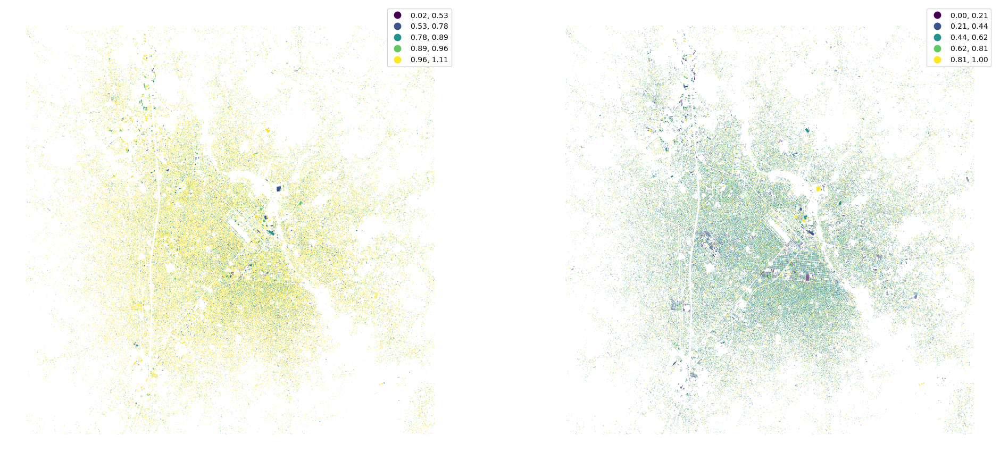

In [85]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

buildings.plot("eri", ax=ax[0], scheme="natural_breaks", legend=True)
buildings.plot("elongation", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

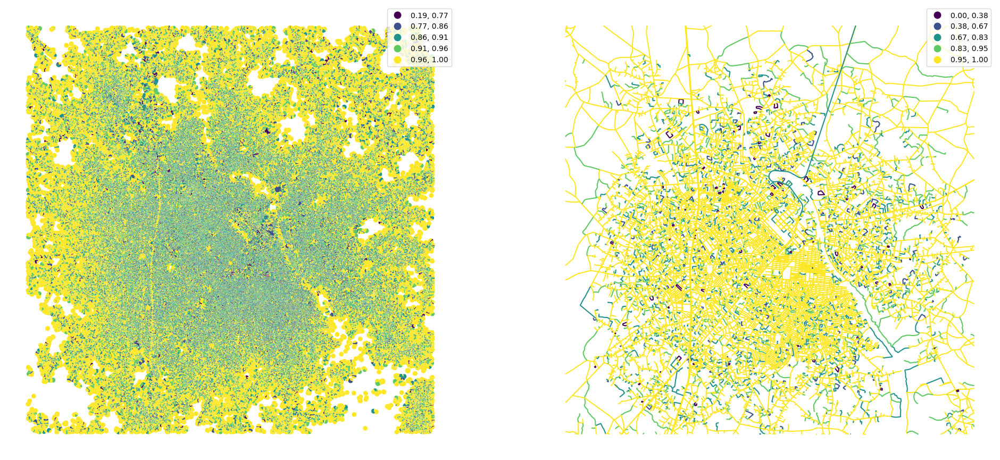

In [86]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

tessellation.plot("convexity", ax=ax[0], scheme="natural_breaks", legend=True)
streets.plot("linearity", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

### Spatial distribution

C:\Users\edoar\anaconda3\envs\geopython\lib\site-packages\momepy\distribution.py:135: FutureWarning: The `query_bulk()` method is deprecated and will be removed in GeoPandas 1.0. You can use the `query()` method instead.
  inp, res = gdf.sindex.query_bulk(gdf.geometry, predicate="intersects")


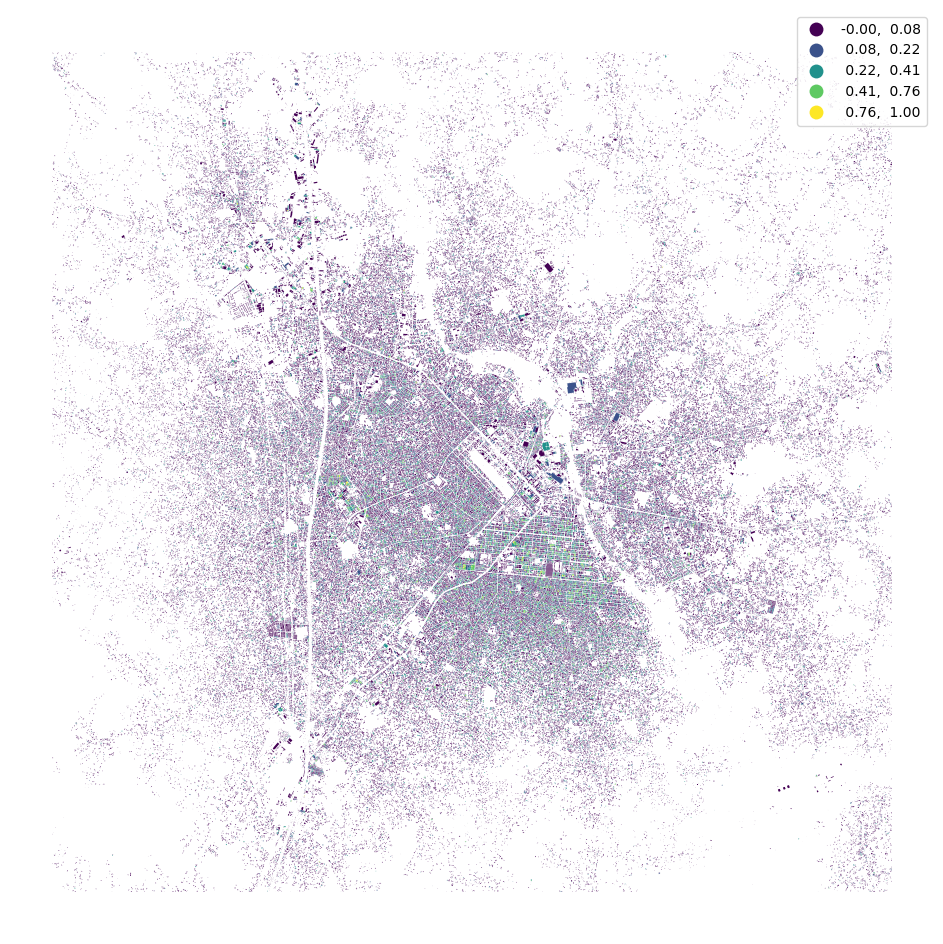

In [87]:
buildings["shared_walls"] = momepy.SharedWallsRatio(buildings).series
buildings.plot("shared_walls", figsize=(12, 12), scheme="natural_breaks", legend=True).set_axis_off()

Generate spatial weights matrix using `libpysal`.

In [88]:
queen_1 = libpysal.weights.contiguity.Queen.from_dataframe(tessellation, ids="uID", silence_warnings=True)

In [89]:
tessellation["neighbors"] = momepy.Neighbors(tessellation, queen_1, "uID", weighted=True, verbose=False).series
tessellation["covered_area"] = momepy.CoveredArea(tessellation, queen_1, "uID", verbose=False).series

with warnings.catch_warnings():
    warnings.simplefilter("ignore")

    buildings["neighbor_distance"] = momepy.NeighborDistance(buildings, queen_1, "uID", verbose=False).series

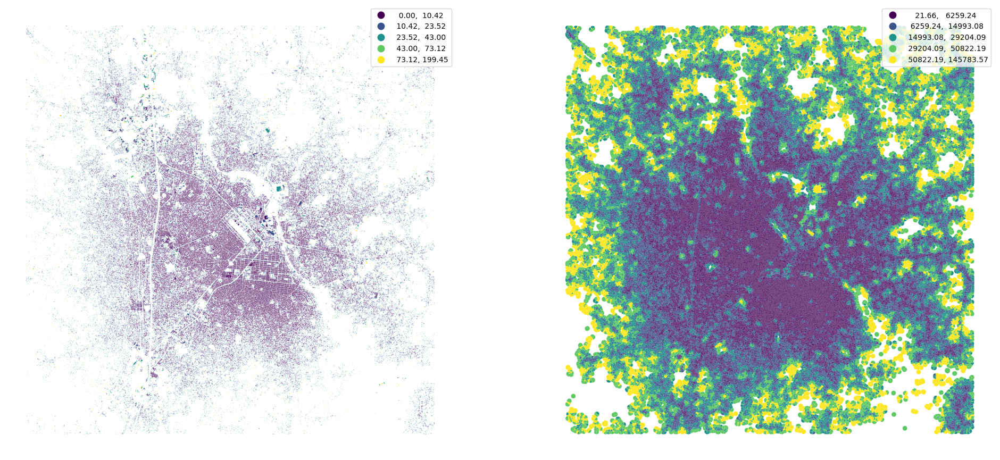

In [90]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

buildings.plot("neighbor_distance", ax=ax[0], scheme="natural_breaks", legend=True)
tessellation.plot("covered_area", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

In [91]:
queen_3 = momepy.sw_high(k=3, weights=queen_1)
buildings_q1 = libpysal.weights.contiguity.Queen.from_dataframe(buildings, silence_warnings=True)

buildings['interbuilding_distance'] = momepy.MeanInterbuildingDistance(buildings, queen_1, 'uID', queen_3, verbose=False).series
buildings['adjacency'] = momepy.BuildingAdjacency(buildings, queen_3, 'uID', buildings_q1, verbose=False).series

C:\Users\edoar\AppData\Local\Temp\ipykernel_25200\3221532125.py:2: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  buildings_q1 = libpysal.weights.contiguity.Queen.from_dataframe(buildings, silence_warnings=True)


In [92]:
buildings.head(50)

,,uID,geometry,index_right1,nID,area,eri,elongation,shared_walls,neighbor_distance,interbuilding_distance,adjacency
0,0,0,"POLYGON Z ((312097.516 557084.023 0.000, 31209...",0,3605,0.181626,0.878289,0.498889,0.000000e+00,NaN,NaN,NaN
1,0,1,"POLYGON Z ((315924.278 557084.023 0.000, 31591...",0,12003,3.565744,0.813304,0.103275,-1.114274e-16,NaN,NaN,NaN
2,0,2,"POLYGON Z ((310886.893 557084.023 0.000, 31088...",0,11567,1.447531,0.796963,0.257076,0.000000e+00,NaN,NaN,NaN
3,0,3,"POLYGON Z ((313232.412 557084.023 0.000, 31322...",0,5589,1.746213,0.802033,0.271750,0.000000e+00,NaN,NaN,NaN
4,0,4,"POLYGON Z ((314009.612 557084.023 0.000, 31400...",0,7169,4.607427,0.867619,0.466845,-1.672254e-16,74.631298,NaN,0.857143
5,0,5,"POLYGON Z ((310498.240 557084.023 0.000, 31049...",0,15298,7.510755,0.969035,0.556820,1.505279e-16,70.138357,NaN,0.928571
6,0,6,"POLYGON Z ((310493.180 557084.023 0.000, 31048...",0,15298,10.724373,0.809973,0.294596,0.000000e+00,61.176256,NaN,0.923077
7,0,7,"POLYGON Z ((315418.865 557084.023 0.000, 31541...",0,20702,9.214758,0.999142,0.764641,0.000000e+00,24.778606,NaN,0.944444
8,0,8,"POLYGON Z ((314320.845 557084.023 0.000, 31431...",0,9757,16.516155,0.967777,0.383556,0.000000e+00,160.935663,NaN,0.976190
9,0,9,"POLYGON Z ((313817.530 557087.169 0.000, 31382...",0,22791,13.045883,0.954939,0.502491,0.000000e+00,59.285987,NaN,0.882353


In [93]:
queen = libpysal.weights.Queen.from_dataframe(tessellation,
                                              silence_warnings=True,
                                              ids='uID')

interblg_distance = momepy.MeanInterbuildingDistance(
    buildings, queen, 'uID')
buildings['mean_ib_dist'] = interblg_distance.series

Computing mean interbuilding distances...


  0%|          | 0/328271 [00:00<?, ?it/s]

In [ ]:
buildings

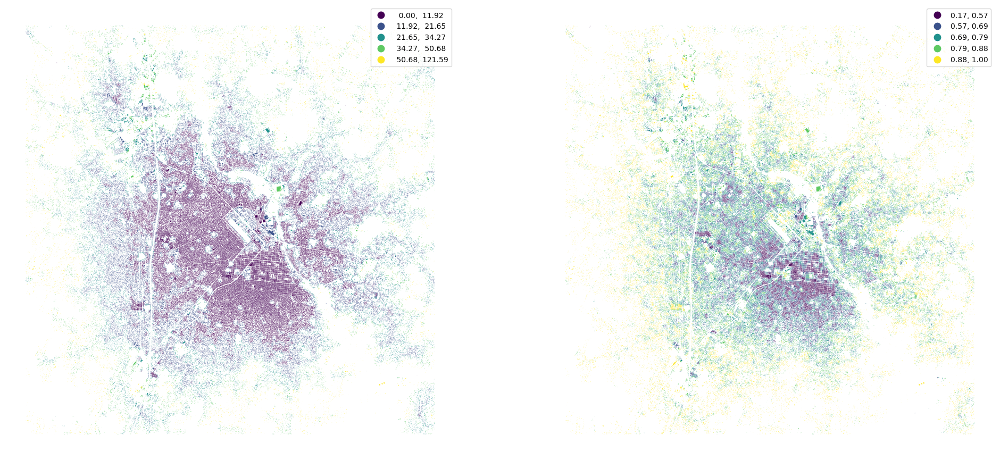

In [94]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

buildings.plot("mean_ib_dist", ax=ax[0], scheme="natural_breaks", legend=True)
buildings.plot("adjacency", ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

In [38]:
buildings = buildings.drop(["interbuilding_distance"], axis=1)
buildings

,,uID,geometry,index_right1,nID,area,eri,elongation,shared_walls,neighbor_distance,adjacency,mean_ib_dist
0,0,0,"POLYGON Z ((300134.676 354852.988 0.000, 30012...",0,1263,23.027323,0.999899,0.580448,0.000000e+00,6.089690,0.965517,13.207587
1,0,1,"POLYGON Z ((298952.505 354893.078 0.000, 29894...",0,657,17.880462,1.000002,0.965293,2.100119e-16,18.099380,0.968750,21.704081
2,0,2,"POLYGON Z ((299617.009 355692.269 0.000, 29961...",0,967,15.011433,1.000005,0.970565,1.146074e-16,10.713630,0.972222,15.296390
3,0,3,"POLYGON Z ((299358.832 355423.853 0.000, 29935...",0,855,57.275696,1.000006,0.932842,-1.172885e-16,12.591955,0.952381,17.847391
4,0,4,"POLYGON Z ((299111.970 354994.719 0.000, 29910...",0,746,18.286905,1.000000,0.907670,0.000000e+00,24.284544,0.894737,25.968517
...,...,...,...,...,...,...,...,...,...,...,...,...
10609,0,10609,"POLYGON Z ((298810.425 355641.746 0.000, 29880...",0,592,77.873861,0.947936,0.608624,0.000000e+00,13.140478,0.886364,19.850171
10610,0,10610,"POLYGON Z ((300725.214 355875.944 0.000, 30072...",0,1479,39.442921,1.000000,0.997474,0.000000e+00,6.281229,0.897959,19.513220
10611,0,10611,"POLYGON Z ((300127.526 355492.747 0.000, 30012...",0,1232,30.055824,1.000035,0.814150,0.000000e+00,5.340153,0.923077,12.564765
10612,0,10612,"POLYGON Z ((300798.067 356110.122 0.000, 30079...",0,1478,38.573925,1.000037,0.754379,0.000000e+00,12.085891,0.970588,30.637471


In [95]:
profile = momepy.StreetProfile(streets, buildings)
streets["width"] = profile.w
streets["width_deviation"] = profile.wd
streets["openness"] = profile.o

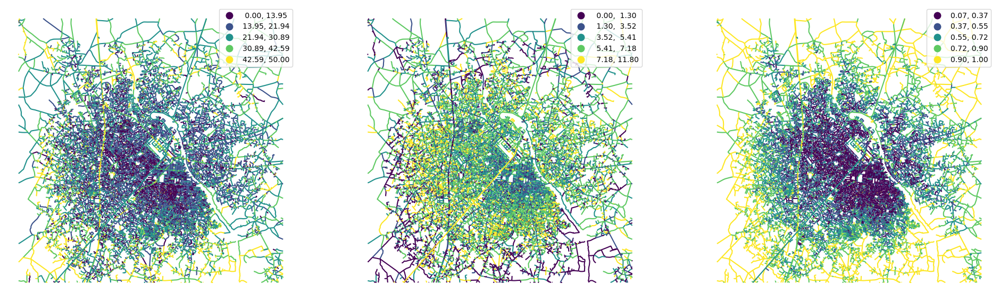

In [96]:
fig, ax = plt.subplots(1, 3, figsize=(24, 12))

streets.plot("width", ax=ax[0], scheme="natural_breaks", legend=True)
streets.plot("width_deviation", ax=ax[1], scheme="natural_breaks", legend=True)
streets.plot("openness", ax=ax[2], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()
ax[2].set_axis_off()

### Intensity

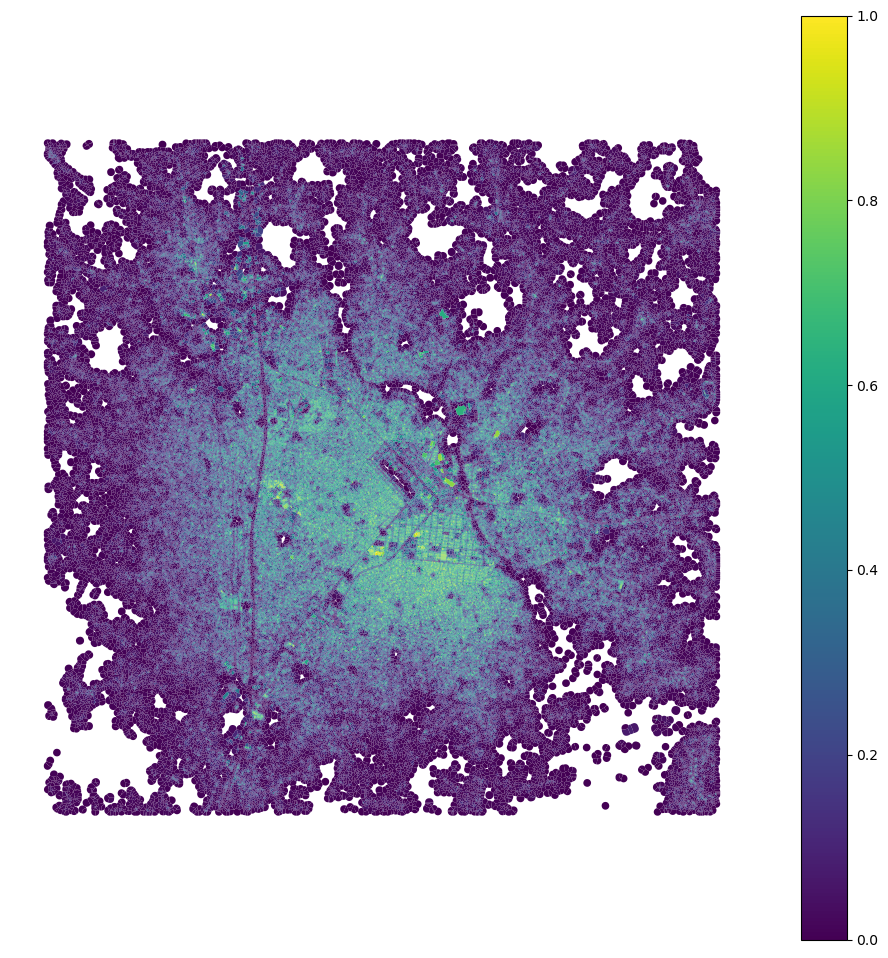

In [97]:
tessellation['car'] = momepy.AreaRatio(tessellation, buildings, 'area', 'area', 'uID').series
tessellation.plot("car", figsize=(12, 12), vmin=0, vmax=1, legend=True).set_axis_off()

### Connectivity

In [98]:
graph = momepy.gdf_to_nx(streets)
graph = momepy.node_degree(graph)
graph = momepy.closeness_centrality(graph, radius=400, distance="mm_len")
graph = momepy.meshedness(graph, radius=400, distance="mm_len")
nodes, streets = momepy.nx_to_gdf(graph)

  0%|          | 0/18880 [00:00<?, ?it/s]

  0%|          | 0/18880 [00:00<?, ?it/s]

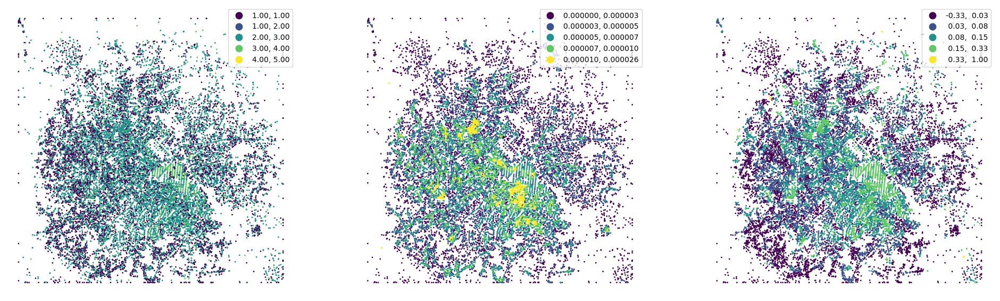

In [99]:
fig, ax = plt.subplots(1, 3, figsize=(24, 12))

nodes.plot("degree", ax=ax[0], scheme="natural_breaks", legend=True, markersize=1)
nodes.plot("closeness", ax=ax[1], scheme="natural_breaks", legend=True, markersize=1, legend_kwds={"fmt": "{:.6f}"})
nodes.plot("meshedness", ax=ax[2], scheme="natural_breaks", legend=True, markersize=1)

ax[0].set_axis_off()
ax[1].set_axis_off()
ax[2].set_axis_off()

In [100]:
buildings["nodeID"] = momepy.get_node_id(buildings, nodes, streets, "nodeID", "nID")

  0%|          | 0/328271 [00:00<?, ?it/s]

Link all data together (to tessellation cells or buildings).

In [45]:
tessellation.head()

,uID,geometry,nID,area,convexity,neighbors,covered_area,car
0,9852,"POLYGON ((299994.041 353594.428, 299995.105 35...",1044,31750.777327,0.996930,0.001545,47655.496709,0.002322
1,531,"POLYGON ((300224.494 353536.933, 300223.461 35...",1323,7213.773842,0.996523,0.017167,29175.744109,0.006319
2,1230,"POLYGON ((300276.404 353658.666, 300276.631 35...",1323,9051.524371,0.999505,0.008339,24208.027766,0.001686
3,3945,"POLYGON ((301034.287 354012.315, 301032.675 35...",1498,33302.531243,1.000000,0.000000,33302.531243,0.000664
4,3342,"POLYGON ((300682.190 354453.017, 300723.487 35...",1482,8953.317142,0.997641,0.013733,25231.992734,0.002444


In [101]:
merged = tessellation.merge(buildings.drop(columns=['nID', 'geometry']), on='uID')
merged = merged.merge(streets.drop(columns='geometry'), on='nID', how='left')
merged = merged.merge(nodes.drop(columns='geometry'), on='nodeID', how='left')

In [ ]:
merged.columns

## Understanding the context

Measure first, second and third quartile of distribution of values within an area around each building.

In [102]:
percentiles = []
for column in merged.columns.drop(["uID", "nodeID", "nID", 'mm_len', 'node_start', 'node_end', "geometry"]):
    perc = momepy.Percentiles(merged, column, queen_3, "uID", verbose=False).frame
    perc.columns = [f"{column}_" + str(x) for x in perc.columns]
    percentiles.append(perc)

In [103]:
percentiles_joined = pandas.concat(percentiles, axis=1)
percentiles_joined.head()

,area_x_25,area_x_50,area_x_75,convexity_25,convexity_50,convexity_75,neighbors_25,neighbors_50,neighbors_75,covered_area_25,...,openness_75,degree_25,degree_50,degree_75,closeness_25,closeness_50,closeness_75,meshedness_25,meshedness_50,meshedness_75
0,1306.407910,2327.143818,5198.764030,0.945499,0.977736,0.989217,0.018614,0.024476,0.034637,15640.628501,...,0.880000,1.0,3.0,3.0,0.000001,0.000001,0.000001,0.0,0.0,0.0
1,1089.059790,2709.642810,5198.764030,0.947475,0.977817,0.989217,0.018614,0.023989,0.032469,16227.995447,...,0.880000,1.0,1.0,3.0,0.000001,0.000001,0.000001,0.0,0.0,0.0
2,1636.713012,2693.345361,4326.552599,0.945984,0.975589,0.986997,0.020219,0.028190,0.034344,17580.949802,...,0.911154,1.0,3.0,3.0,0.000001,0.000001,0.000001,0.0,0.0,0.0
3,1636.713012,2676.383633,4326.552599,0.945137,0.974816,0.986997,0.020219,0.028403,0.034344,17580.949802,...,0.880000,1.0,3.0,3.0,0.000001,0.000001,0.000001,0.0,0.0,0.0
4,1221.073790,2256.245971,3773.023193,0.944209,0.972953,0.989594,0.023015,0.030195,0.036109,13364.922005,...,0.934426,2.0,3.0,4.0,0.000001,0.000001,0.000002,0.0,0.0,0.0


See the difference between original convexity and spatially lagged one.

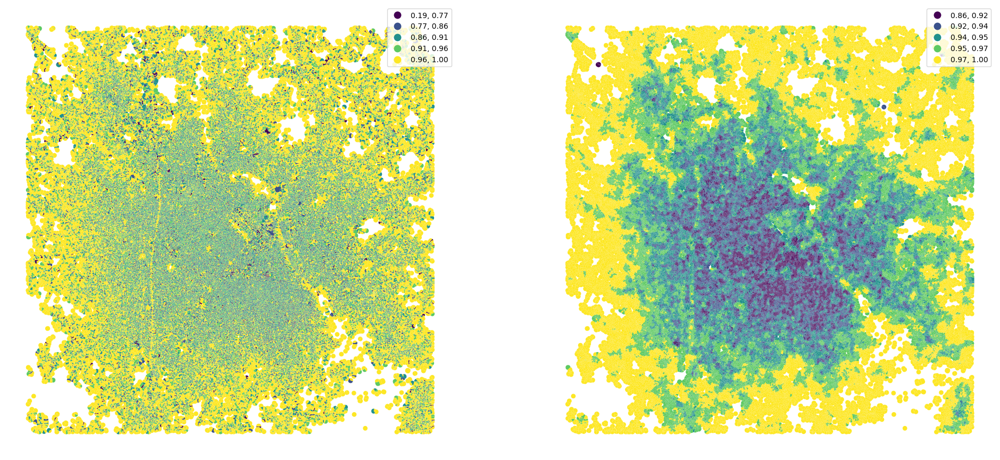

In [104]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))

tessellation.plot("convexity", ax=ax[0], scheme="natural_breaks", legend=True)
merged.plot(percentiles_joined['convexity_50'].values, ax=ax[1], scheme="natural_breaks", legend=True)

ax[0].set_axis_off()
ax[1].set_axis_off()

## Clustering

Now we can use obtained values within a cluster analysis that should detect types of urban structure.

Standardize values before clustering.

In [105]:
standardized = (percentiles_joined - percentiles_joined.mean()) / percentiles_joined.std()
standardized.head()

,area_x_25,area_x_50,area_x_75,convexity_25,convexity_50,convexity_75,neighbors_25,neighbors_50,neighbors_75,covered_area_25,...,openness_75,degree_25,degree_50,degree_75,closeness_25,closeness_50,closeness_75,meshedness_25,meshedness_50,meshedness_75
0,1.387021,1.481926,2.197342,1.736698,1.865701,1.610113,-1.825386,-1.830556,-1.667137,2.071246,...,1.269487,-1.449937,0.215026,-0.182978,-1.045197,-1.241163,-1.352619,-0.975904,-1.108425,-1.220117
1,1.029904,1.863625,2.197342,1.816351,1.870265,1.610113,-1.825386,-1.853931,-1.751405,2.185502,...,1.269487,-1.449937,-2.583702,-0.182978,-1.045197,-1.246916,-1.385327,-0.975904,-1.108425,-1.220117
2,1.929732,1.847362,1.684375,1.756234,1.744966,1.411888,-1.735390,-1.652423,-1.678520,2.448682,...,1.417925,-1.449937,0.215026,-0.182978,-1.045197,-1.241163,-1.352619,-0.975904,-1.108425,-1.220117
3,1.929732,1.830435,1.684375,1.722088,1.701500,1.411888,-1.735390,-1.642205,-1.678520,2.448682,...,1.269487,-1.449937,0.215026,-0.182978,-1.045197,-1.206683,-1.352619,-0.975904,-1.108425,-1.220117
4,1.246811,1.411176,1.358833,1.684701,1.596733,1.643822,-1.578647,-1.556297,-1.609952,1.628570,...,1.528811,-0.412427,0.215026,1.669794,-1.039173,-1.195718,-1.259591,-0.975904,-1.108425,-1.220117


### How many clusters?

To determine how many clusters we should aim for, we can use a little package called `clustergram`. See its [documentation](https://clustergram.readthedocs.io) for details.

In [106]:
cgram = Clustergram(range(1, 12), n_init=50, random_state=42)
cgram.fit(standardized.fillna(0))

show(cgram.bokeh())

K=1 skipped. Mean computed from data directly.
K=2 fitted in 17.939 seconds.
K=3 fitted in 23.040 seconds.
K=4 fitted in 37.649 seconds.
K=5 fitted in 40.210 seconds.
K=6 fitted in 61.425 seconds.
K=7 fitted in 98.551 seconds.
K=8 fitted in 97.273 seconds.
K=9 fitted in 90.800 seconds.
K=10 fitted in 98.332 seconds.
K=11 fitted in 93.587 seconds.


NameError: name 'sns' is not defined

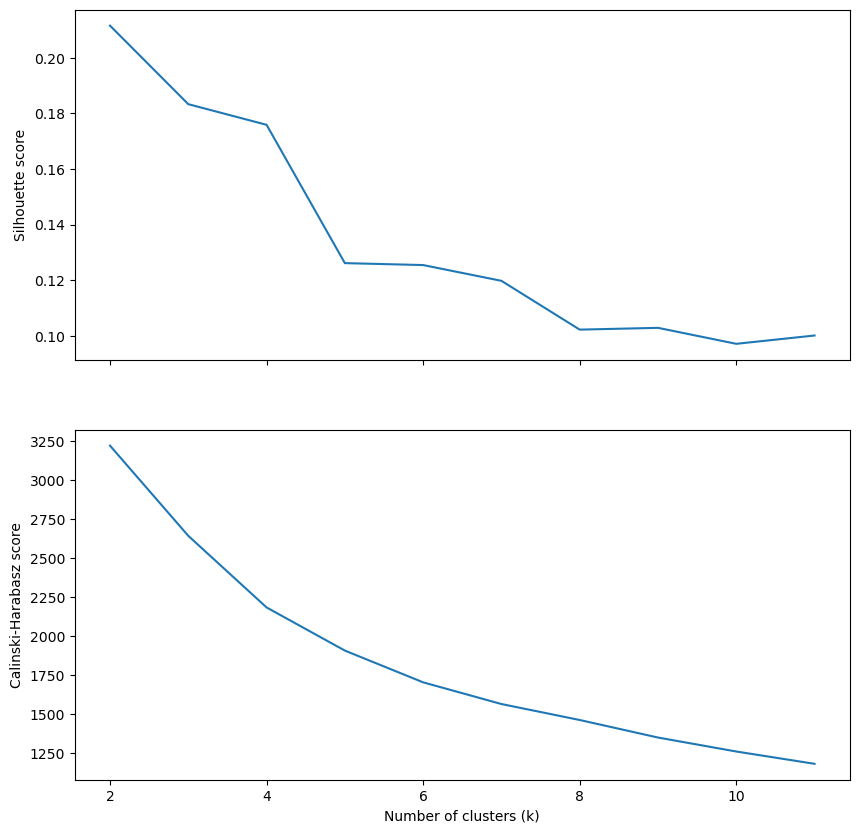

In [53]:
fig, axs = plt.subplots(2, figsize=(10, 10), sharex=True)
cgram.silhouette_score().plot(xlabel="Number of clusters (k)", ylabel="Silhouette score", ax=axs[0])
cgram.calinski_harabasz_score().plot(xlabel="Number of clusters (k)", ylabel="Calinski-Harabasz score", ax=axs[1])
sns.despine(offset=10)

Clustegram gives us also the final labels. (Normally, you would run the final clustering on much larger number of initialisations.)

In [54]:
cgram.labels.head()

,1,2,3,4,5,6,7,8,9,10,11
0,0,1,2,2,1,3,1,5,5,8,10
1,0,1,2,2,2,0,3,3,2,0,0
2,0,1,2,1,2,0,3,3,2,0,4
3,0,1,2,2,1,5,6,6,8,6,7
4,0,1,2,2,1,3,1,5,5,8,10


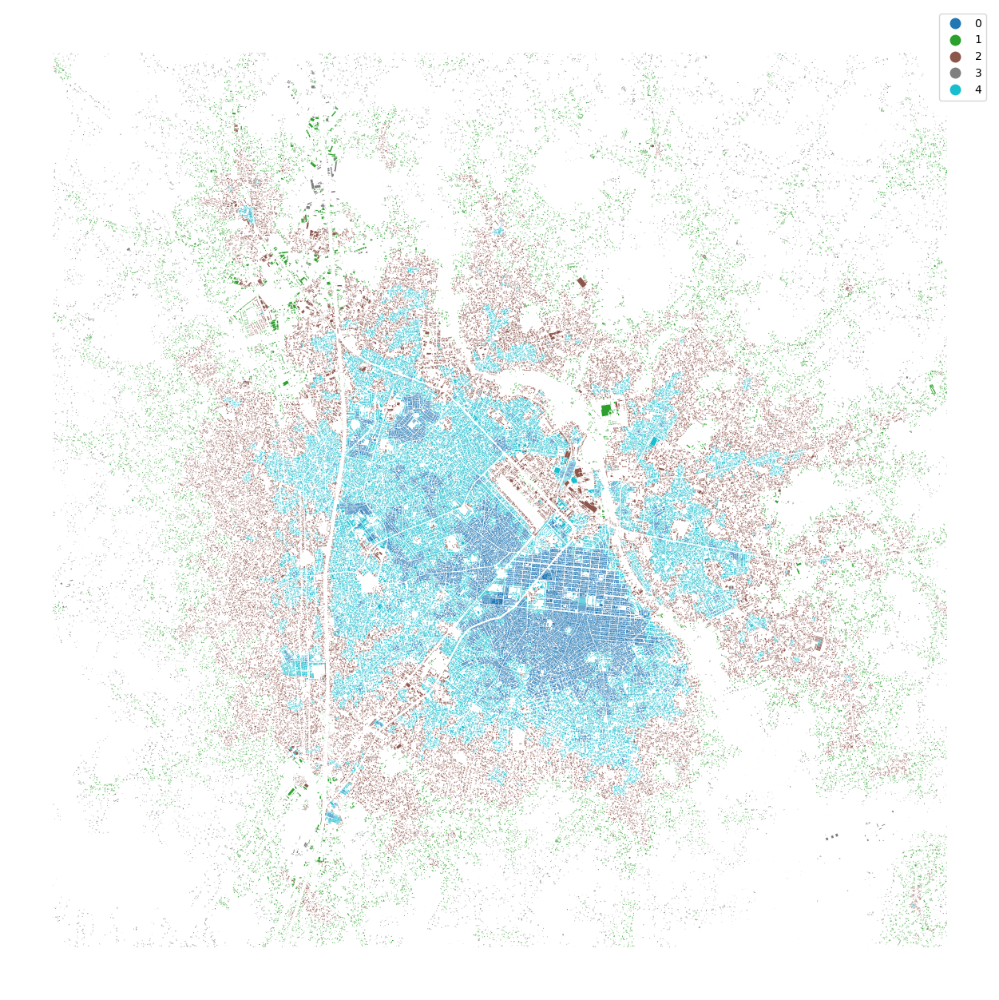

In [107]:
merged["cluster"] = cgram.labels[5].values
urban_types = buildings[["geometry", "uID"]].merge(merged[["uID", "cluster"]], on="uID")
urban_types.plot("cluster", categorical=True, figsize=(16, 16), legend=True).set_axis_off()

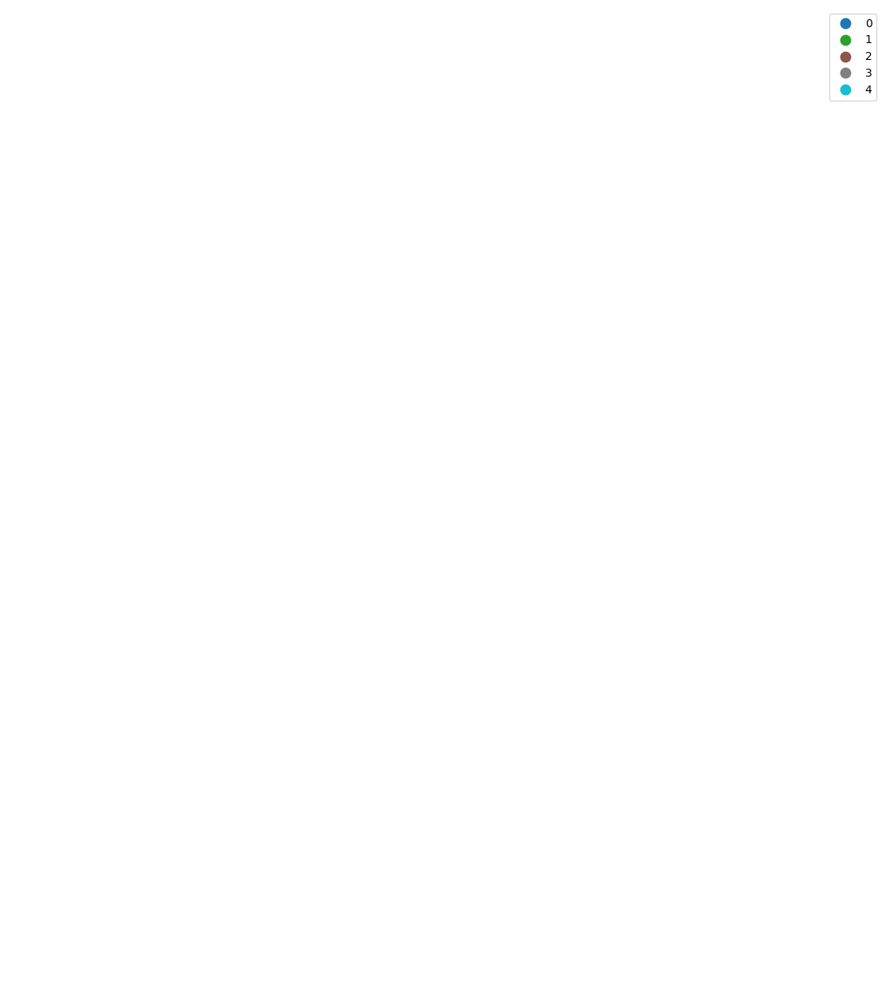

In [108]:
ax = urban_types.plot("cluster", categorical=True, figsize=(16, 16), legend=True)
ax.set_xlim(-645000, -641000)
ax.set_ylim(-1195500, -1191000)
ax.set_axis_off()

In [ ]:
urban_types.head()

In [109]:
# Escaping backslashes
urban_types.to_file("D:\\Work\\UN\\Somalia\\Data\\Urban_morphology\\urbans2_aba_clipver.shp")
